In [1]:
import torch
import torch.nn as nn
import random
import torch.optim as optim
import numpy as np
from collections import deque
import torch.nn.functional as F

In [2]:
class DQNAgent:
    def __init__(self, state_dim, action_dim, epsilon=0.1, gamma=0.99, lr=1e-3, target_update=10):
        self.state_dim = state_dim
        self.action_dim = action_dim
        self.epsilon = epsilon
        self.gamma = gamma
        self.lr = lr
        self.target_update = target_update

        # Q-Networks
        self.q_network = nn.Sequential(
            nn.Linear(state_dim, 128),
            nn.ReLU(),
            nn.Linear(128, 128),
            nn.ReLU(),
            nn.Linear(128, action_dim)
        )
        self.target_network = nn.Sequential(
            nn.Linear(state_dim, 128),
            nn.ReLU(),
            nn.Linear(128, 128),
            nn.ReLU(),
            nn.Linear(128, action_dim)
        )
        self.target_network.load_state_dict(self.q_network.state_dict())
        self.target_network.eval()

        self.optimizer = optim.Adam(self.q_network.parameters(), lr=lr)
        self.memory = []
        self.batch_size = 64
        self.max_memory = 10000
        self.steps = 0

    def act(self, state):
        if random.random() < self.epsilon:
            return random.randint(0, self.action_dim - 1)
        state_tensor = torch.FloatTensor(state).unsqueeze(0)
        with torch.no_grad():
            q_values = self.q_network(state_tensor)
        return torch.argmax(q_values).item()

    def store_transition(self, state, action, reward, next_state, done):
        if len(self.memory) >= self.max_memory:
            self.memory.pop(0)
        self.memory.append((state, action, reward, next_state, done))

    def train(self):
        if len(self.memory) < self.batch_size:
            return

        batch = random.sample(self.memory, self.batch_size)
        states, actions, rewards, next_states, dones = zip(*batch)

        states = torch.FloatTensor(states)
        actions = torch.LongTensor(actions).unsqueeze(1)
        rewards = torch.FloatTensor(rewards).unsqueeze(1)
        next_states = torch.FloatTensor(next_states)
        dones = torch.FloatTensor(dones).unsqueeze(1)

        # Compute Q values
        q_values = self.q_network(states).gather(1, actions)

        # Compute target Q values
        with torch.no_grad():
            max_next_q_values = self.target_network(next_states).max(1, keepdim=True)[0]
            target_q_values = rewards + self.gamma * max_next_q_values * (1 - dones)

        # Compute loss
        loss = nn.MSELoss()(q_values, target_q_values)

        # Optimize
        self.optimizer.zero_grad()
        loss.backward()
        self.optimizer.step()

        # Update target network
        if self.steps % self.target_update == 0:
            self.target_network.load_state_dict(self.q_network.state_dict())
        self.steps += 1


In [3]:
class A2CAgent:
    def __init__(self, state_dim, action_dim, lr=1e-4, gamma=0.99, continuous=False, entropy_coef=0.01):
        self.action_dim = action_dim
        self.state_dim = state_dim
        self.gamma = gamma
        self.continuous = continuous
        self.entropy_coef = entropy_coef

        # Actor-Critic Networks with shared features
        self.shared_layers = nn.Sequential(
            nn.Linear(state_dim, 128),
            nn.ReLU(),
            nn.Linear(128, 128),
            nn.ReLU()
        )

        if continuous:
            self.actor_mean = nn.Linear(128, action_dim)
            self.actor_std = nn.Parameter(torch.zeros(action_dim))
        else:
            self.actor = nn.Linear(128, action_dim)

        self.critic = nn.Linear(128, 1)

        # Optimizer
        self.optimizer = optim.Adam(self.parameters(), lr=lr)

    def parameters(self):
        if self.continuous:
            return list(self.shared_layers.parameters()) + \
                   list(self.actor_mean.parameters()) + \
                   [self.actor_std] + \
                   list(self.critic.parameters())
        else:
            return list(self.shared_layers.parameters()) + \
                   list(self.actor.parameters()) + \
                   list(self.critic.parameters())

    def get_action_distribution(self, state_tensor):
        features = self.shared_layers(state_tensor)
        if self.continuous:
            mean = self.actor_mean(features)
            std = F.softplus(self.actor_std).expand_as(mean)
            return torch.distributions.Normal(mean, std)
        else:
            logits = self.actor(features)
            return torch.distributions.Categorical(logits=logits)

    def act(self, state):
        state_tensor = torch.FloatTensor(state).unsqueeze(0)
        with torch.no_grad():
            dist = self.get_action_distribution(state_tensor)
            if self.continuous:
                action = dist.sample()
                action = torch.clamp(action, -1, 1)  # Clip actions to valid range
                return action.squeeze(0).numpy()
            else:
                action = dist.sample()
                return action.item()

    def compute_returns(self, rewards, dones, next_state_values):
        returns = torch.zeros_like(rewards)
        future_return = next_state_values[-1] * (1 - dones[-1])

        for t in reversed(range(len(rewards))):
            future_return = rewards[t] + self.gamma * future_return * (1 - dones[t])
            returns[t] = future_return
        return returns

    def train(self, states, actions, rewards, next_states, dones):
        # Convert to tensors
        states = torch.FloatTensor(states)
        next_states = torch.FloatTensor(next_states)
        rewards = torch.FloatTensor(rewards).unsqueeze(1)
        dones = torch.FloatTensor(dones).unsqueeze(1)

        if self.continuous:
            actions = torch.FloatTensor(actions)
        else:
            actions = torch.LongTensor(actions)

        # Get shared features
        features = self.shared_layers(states)
        next_features = self.shared_layers(next_states)

        # Get values
        values = self.critic(features)
        next_values = self.critic(next_features).detach()

        # Compute returns and advantages
        returns = self.compute_returns(rewards, dones, next_values)
        advantages = returns - values.detach()

        # Get action distributions
        dist = self.get_action_distribution(states)

        # Compute policy loss
        if self.continuous:
            log_probs = dist.log_prob(actions).sum(dim=-1, keepdim=True)
        else:
            log_probs = dist.log_prob(actions).unsqueeze(1)

        # Policy loss with entropy bonus
        entropy = dist.entropy().mean()
        policy_loss = -(log_probs * advantages).mean() - self.entropy_coef * entropy

        # Value loss
        value_loss = F.mse_loss(values, returns)

        # Combined loss
        total_loss = policy_loss + 0.5 * value_loss

        # Optimize
        self.optimizer.zero_grad()
        total_loss.backward()
        torch.nn.utils.clip_grad_norm_(self.parameters(), max_norm=0.5)
        self.optimizer.step()

        return {
            'policy_loss': policy_loss.item(),
            'value_loss': value_loss.item(),
            'entropy': entropy.item()
        }

In [4]:
class OUNoise:
    def __init__(self, size, mu=0., theta=0.15, sigma=0.2):
        self.mu = mu * np.ones(size)
        self.theta = theta
        self.sigma = sigma
        self.reset()

    def reset(self):
        self.state = np.copy(self.mu)

    def sample(self):
        x = self.state
        dx = self.theta * (self.mu - x) + self.sigma * np.random.randn(len(x))
        self.state = x + dx
        return self.state

class StateNormalizer:
    def __init__(self, epsilon=4e-8):
        self.mean = None
        self.std = None
        self.epsilon = epsilon

    def fit(self, states):
        self.mean = np.mean(states, axis=0)
        self.std = np.std(states, axis=0) + self.epsilon

    def transform(self, state):
        if self.mean is None:
            return state
        return (state - self.mean) / self.std

    def inverse_transform(self, normalized_state):
        return normalized_state * self.std + self.mean

class DDPGAgent:
    def __init__(self, state_dim, action_dim, action_bounds, gamma=0.99, lr=3e-4, tau=0.005,
                 min_trade_amount=1000, max_trade_amount=100000):
        self.state_dim = state_dim
        self.action_dim = action_dim
        self.action_bounds = action_bounds
        self.gamma = gamma
        self.tau = tau
        self.device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

        # Actor Network
        self.actor = nn.Sequential(
            nn.Linear(state_dim, 256),
            nn.LayerNorm(256),
            nn.ReLU(),
            nn.Linear(256, 256),
            nn.LayerNorm(256),
            nn.ReLU(),
            nn.Linear(256, action_dim),
            nn.Tanh()
        ).to(self.device)

        self.target_actor = nn.Sequential(
            nn.Linear(state_dim, 256),
            nn.LayerNorm(256),
            nn.ReLU(),
            nn.Linear(256, 256),
            nn.LayerNorm(256),
            nn.ReLU(),
            nn.Linear(256, action_dim),
            nn.Tanh()
        ).to(self.device)

        self.target_actor.load_state_dict(self.actor.state_dict())

        # Critic Network
        self.critic = nn.Sequential(
            nn.Linear(state_dim + action_dim, 256),
            nn.LayerNorm(256),
            nn.ReLU(),
            nn.Linear(256, 256),
            nn.LayerNorm(256),
            nn.ReLU(),
            nn.Linear(256, 1)
        ).to(self.device)

        self.target_critic = nn.Sequential(
            nn.Linear(state_dim + action_dim, 256),
            nn.LayerNorm(256),
            nn.ReLU(),
            nn.Linear(256, 256),
            nn.LayerNorm(256),
            nn.ReLU(),
            nn.Linear(256, 1)
        ).to(self.device)

        self.target_critic.load_state_dict(self.critic.state_dict())

        # Optimizers
        self.actor_optimizer = optim.Adam(self.actor.parameters(), lr=lr)
        self.critic_optimizer = optim.Adam(self.critic.parameters(), lr=lr)

        # Noise process
        self.noise = OUNoise(action_dim)

        # Replay buffer
        self.memory = deque(maxlen=100000)
        self.batch_size = 256

        self.min_trade_amount = min_trade_amount
        self.max_trade_amount = max_trade_amount
        self.state_normalizer = StateNormalizer()

    def scale_action_to_trade_amount(self, action):
        """Scale normalized action (-1, 1) to actual trade amount"""
        scaled_action = action * self.max_trade_amount
        # Apply minimum trade threshold
        scaled_action = np.where(
            np.abs(scaled_action) < self.min_trade_amount,
            0,
            scaled_action
        )
        return np.clip(scaled_action, -self.max_trade_amount, self.max_trade_amount)

    def act(self, state, evaluate=False):
        # Normalize state
        normalized_state = self.state_normalizer.transform(state)
        normalized_state = torch.FloatTensor(normalized_state).unsqueeze(0).to(self.device)

        with torch.no_grad():
            normalized_action = self.actor(normalized_state).cpu().numpy().flatten()
            if not evaluate:
                normalized_action += self.noise.sample()
                normalized_action = np.clip(normalized_action, -1, 1)

            # Scale to actual trade amount
            real_action = self.scale_action_to_trade_amount(normalized_action)

        return real_action

    def store_transition(self, state, action, reward, next_state, done):
        # Normalize state and action before storing
        normalized_state = self.state_normalizer.transform(state)
        normalized_next_state = self.state_normalizer.transform(next_state)
        normalized_action = action / self.max_trade_amount  # Scale action back to [-1, 1]

        self.memory.append((normalized_state, normalized_action, reward, normalized_next_state, done))

    def train(self):
        if len(self.memory) < self.batch_size:
            return

        # Update state normalizer periodically
        if len(self.memory) % 1000 == 0:
            states = np.vstack([t[0] for t in self.memory])
            self.state_normalizer.fit(states)

        # Sample batch
        batch = random.sample(self.memory, self.batch_size)
        state, action, reward, next_state, done = map(np.vstack, zip(*batch))

        # Convert to tensors
        state = torch.FloatTensor(state).to(self.device)
        action = torch.FloatTensor(action).to(self.device)
        reward = torch.FloatTensor(reward).to(self.device)
        next_state = torch.FloatTensor(next_state).to(self.device)
        done = torch.FloatTensor(1 - done).to(self.device)

        # Update critic
        with torch.no_grad():
            next_action = self.target_actor(next_state)
            target_q = reward + done * self.gamma * self.target_critic(
                torch.cat([next_state, next_action], dim=1))

        current_q = self.critic(torch.cat([state, action], dim=1))
        critic_loss = nn.MSELoss()(current_q, target_q)

        self.critic_optimizer.zero_grad()
        critic_loss.backward()
        self.critic_optimizer.step()

        # Update actor
        actor_loss = -self.critic(torch.cat([state, self.actor(state)], dim=1)).mean()

        self.actor_optimizer.zero_grad()
        actor_loss.backward()
        self.actor_optimizer.step()

        # Update target networks
        for target_param, param in zip(self.target_critic.parameters(), self.critic.parameters()):
            target_param.data.copy_(self.tau * param + (1.0 - self.tau) * target_param)

        for target_param, param in zip(self.target_actor.parameters(), self.actor.parameters()):
            target_param.data.copy_(self.tau * param + (1.0 - self.tau) * target_param)

        return {
            'critic_loss': critic_loss.item(),
            'actor_loss': actor_loss.item()
        }

    def save(self, path):
        torch.save({
            'actor': self.actor.state_dict(),
            'critic': self.critic.state_dict(),
            'target_actor': self.target_actor.state_dict(),
            'target_critic': self.target_critic.state_dict(),
            'actor_optimizer': self.actor_optimizer.state_dict(),
            'critic_optimizer': self.critic_optimizer.state_dict(),
        }, path)

    def load(self, path):
        checkpoint = torch.load(path)
        self.actor.load_state_dict(checkpoint['actor'])
        self.critic.load_state_dict(checkpoint['critic'])
        self.target_actor.load_state_dict(checkpoint['target_actor'])
        self.target_critic.load_state_dict(checkpoint['target_critic'])
        self.actor_optimizer.load_state_dict(checkpoint['actor_optimizer'])
        self.critic_optimizer.load_state_dict(checkpoint['critic_optimizer'])

In [5]:
import gym
from gym import spaces

class TradingEnv(gym.Env):
    def __init__(self, data, initial_cash=10000, lookback=5, action_space_type="discrete"):
        super(TradingEnv, self).__init__()

        # Store data and parameters
        self.data = data.values
        self.initial_cash = initial_cash
        self.lookback = lookback
        self.action_space_type = action_space_type

        # Define action space
        if action_space_type == "discrete":
            self.action_space = spaces.Discrete(3)  # 0: Hold, 1: Buy, 2: Sell
        elif action_space_type == "continuous":
            self.action_space = spaces.Box(low=-1, high=1, shape=(1,), dtype=np.float32)  # -1: Max sell, 1: Max buy
        else:
            raise ValueError("Invalid action_space_type. Choose 'discrete' or 'continuous'.")

        # Observation space: OHLC history + portfolio info
        self.observation_space = spaces.Box(
            low=-np.inf, high=np.inf, shape=(lookback * 4 + 3,), dtype=np.float32
        )

        # Initialize variables
        self.reset()

    def reset(self):
        """Reset environment to the initial state."""
        self.current_step = self.lookback
        self.cash = self.initial_cash
        self.shares_held = 0
        self.done = False

        # Portfolio value: cash + value of held shares
        self.portfolio_value = self.cash
        self.previous_portfolio_value = self.portfolio_value

        return self._get_observation()

    def _get_observation(self):
        """Construct the observation."""
        ohlc_history = self.data[self.current_step - self.lookback : self.current_step, :].astype(np.float32)
        portfolio_state = np.array([self.cash, self.shares_held, self.portfolio_value], dtype=np.float32)
        return np.concatenate((ohlc_history.flatten(), portfolio_state))

    def step(self, action):
        """Execute one step in the environment."""
        if self.done:
            raise RuntimeError("Step called on a finished environment. Reset the environment first.")

        current_price = self.data[self.current_step, 3]  # Use 'Close' price for trading

        if self.action_space_type == "discrete":
            # 0: Hold, 1: Buy, 2: Sell
            if action == 1:  # Buy all available with cash
                self._buy_shares(current_price, fraction=1.0)
            elif action == 2:  # Sell all shares held
                self._sell_shares(current_price, fraction=1.0)

        elif self.action_space_type == "continuous":
            # Continuous action: -1 (sell all) to +1 (buy all)
            action_value = np.clip(action[0], -1, 1)  # Extract scalar from array
            if action_value > 0:  # Buy proportion
                self._buy_shares(current_price, fraction=action_value)
            elif action_value < 0:  # Sell proportion
                self._sell_shares(current_price, fraction=-action_value)

        # Update portfolio value
        self.previous_portfolio_value = self.portfolio_value
        self.portfolio_value = self.cash + self.shares_held * current_price

        # Calculate reward
        reward = self.portfolio_value - self.previous_portfolio_value

        # Move to the next step
        self.current_step += 1

        # Check if we're done
        if self.current_step >= len(self.data) - 1 or self.portfolio_value <= 0:
            self.done = True

        # Create the next observation
        observation = self._get_observation()

        # Debug prints
        print(f"Step: {self.current_step}, Action: {action}, Reward: {reward}, Portfolio Value: {self.portfolio_value}")

        return observation, reward, self.done, {}

    def _buy_shares(self, price, fraction):
        """Buy a fraction of shares with available cash."""
        if price <= 0 or fraction <= 0:
            return
        amount_to_invest = self.cash * fraction
        shares_to_buy = amount_to_invest // price
        self.cash -= shares_to_buy * price
        self.shares_held += shares_to_buy

    def _sell_shares(self, price, fraction):
        """Sell a fraction of shares held."""
        if price <= 0 or fraction <= 0:
            return
        shares_to_sell = int(self.shares_held * fraction)
        self.cash += shares_to_sell * price
        self.shares_held -= shares_to_sell

    def render(self):
        """Render the current state."""
        print(f"Step: {self.current_step}")
        print(f"Price: {self.data[self.current_step, 3]} (Close)")
        print(f"Cash: {self.cash}")
        print(f"Shares Held: {self.shares_held}")
        print(f"Portfolio Value: {self.portfolio_value}")


In [6]:
from yfinance import download as yf_download

def train_model(agent, env, num_episodes=500, max_steps=200):
    if model == "a2c":
        rewards_history = []
        for episode in range(num_episodes):
            state = env.reset()
            total_reward = 0
            states, actions, rewards, next_states, dones = [], [], [], [], []
            for step in range(max_steps):
                action = agent.act(state)
                next_state, reward, done, _ = env.step(action)
                states.append(state)
                actions.append(action)
                rewards.append(reward)
                next_states.append(next_state)
                dones.append(done)
                state = next_state
                total_reward += reward
                if done:
                    break
            agent.train(states, actions, rewards, next_states, dones)
            rewards_history.append(total_reward)
            print(f"Episode {episode + 1}/{num_episodes}, Total Reward: {total_reward}")
        return rewards_history
    else:
        rewards_history = []
        for episode in range(num_episodes):
            state = env.reset()
            total_reward = 0
            for step in range(max_steps):
                action = agent.act(state)
                next_state, reward, done, _ = env.step(action)
                agent.store_transition(state, action, reward, next_state, done)
                agent.train()
                state = next_state
                total_reward += reward
                if done:
                    break
            rewards_history.append(total_reward)
            print(f"Episode {episode + 1}/{num_episodes}, Total Reward: {total_reward}")
        return rewards_history


def backtest(agent, env, max_steps=200):
    """
    Backtest the trained agent.
    """
    state = env.reset()
    total_reward = 0
    actions = []
    for step in range(max_steps):
        action = agent.act(state)
        next_state, reward, done, _ = env.step(action)
        state = next_state
        total_reward += reward
        actions.append(action)
        if done:
            break
    print(f"Backtest Total Reward: {total_reward}")
    return total_reward, actions

def fetch_ohlc_data(ticker, start_date, end_date):
    """
    Fetch OHLC data using yfinance.
    """
    data = yf_download(ticker, start=start_date, end=end_date, interval="1d")
    data = data[['Open', 'High', 'Low', 'Close']].dropna()
    return data

In [ ]:
##Set the parameters to be inputted

In [11]:
model="dqn" #The model want to use
ticker="AAPL" # the stock selected
start_date="2010-01-01" # the start date of the stock
end_date="2020-01-01" # the end date of the stock
epsilon=0.1
discrete=True
episodes=500

In [9]:
def strock_trade_agent_train(model,ticker,start_date,end_date,epsilon,discrete,episodes):

    # Fetch OHLC data
    ohlc_data = fetch_ohlc_data(ticker,start_date,end_date)
    env = TradingEnv(ohlc_data, action_space_type="discrete" if discrete else "continuous")

    # Initialize agent
    state_dim = env.observation_space.shape[0]
    action_dim = env.action_space.n if discrete else env.action_space.shape[0]
    if model == "dqn":
        agent = DQNAgent(state_dim, action_dim, epsilon=epsilon)
    elif model == "ddpg":
        agent = DDPGAgent(state_dim, action_dim, action_bounds=1.0)
    elif model == "a2c":
        agent = A2CAgent(state_dim, action_dim, continuous=not discrete)
    else:
      raise ValueError(f"Invalid model type: {model}")

    # Train the agent
    print(f"Training {model.upper()}...")
    train_rewards = train_model(agent, env, num_episodes=episodes)

    # Backtest the agent
    print(f"Backtesting {model.upper()}...")
    total_reward, actions = backtest(agent, env)

    # Save results
    np.save(f"{model}_train_rewards.npy", train_rewards)
    np.save(f"{model}_backtest_actions.npy", actions)
    torch.save(agent, f"{model}_agent.pt")
    print(f"Results and model saved for {model.upper()}!")

    return agent

In [12]:
agent_dqn = strock_trade_agent_train(model,ticker,start_date,end_date,epsilon,discrete,episodes)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
[*********************100%***********************]  1 of 1 completed


Training DQN...
Step: 6, Action: 0, Reward: 0.0, Portfolio Value: 10000.0
Step: 7, Action: 0, Reward: 0.0, Portfolio Value: 10000.0
Step: 8, Action: 0, Reward: 0.0, Portfolio Value: 10000.0
Step: 9, Action: 0, Reward: 0.0, Portfolio Value: 10000.0
Step: 10, Action: 0, Reward: 0.0, Portfolio Value: 10000.0
Step: 11, Action: 0, Reward: 0.0, Portfolio Value: 10000.0
Step: 12, Action: 0, Reward: 0.0, Portfolio Value: 10000.0
Step: 13, Action: 0, Reward: 0.0, Portfolio Value: 10000.0
Step: 14, Action: 0, Reward: 0.0, Portfolio Value: 10000.0
Step: 15, Action: 0, Reward: 0.0, Portfolio Value: 10000.0
Step: 16, Action: 0, Reward: 0.0, Portfolio Value: 10000.0
Step: 17, Action: 0, Reward: 0.0, Portfolio Value: 10000.0
Step: 18, Action: 0, Reward: 0.0, Portfolio Value: 10000.0
Step: 19, Action: 0, Reward: 0.0, Portfolio Value: 10000.0
Step: 20, Action: 0, Reward: 0.0, Portfolio Value: 10000.0
Step: 21, Action: 0, Reward: 0.0, Portfolio Value: 10000.0
Step: 22, Action: 0, Reward: 0.0, Portfolio 

<ipython-input-2-61fcb67ebc7c>:54: UserWarning: Creating a tensor from a list of numpy.ndarrays is extremely slow. Please consider converting the list to a single numpy.ndarray with numpy.array() before converting to a tensor. (Triggered internally at ../torch/csrc/utils/tensor_new.cpp:278.)
  states = torch.FloatTensor(states)


流式输出内容被截断，只能显示最后 5000 行内容。
Step: 33, Action: 0, Reward: -60.07510185241699, Portfolio Value: 9617.420907020569
Step: 34, Action: 0, Reward: -59.598305225372314, Portfolio Value: 9557.822601795197
Step: 35, Action: 0, Reward: -160.1998472213745, Portfolio Value: 9397.622754573822
Step: 36, Action: 0, Reward: 171.64360284805298, Portfolio Value: 9569.266357421875
Step: 37, Action: 0, Reward: 63.88883829116821, Portfolio Value: 9633.155195713043
Step: 38, Action: 0, Reward: 124.91753339767456, Portfolio Value: 9758.072729110718
Step: 39, Action: 2, Reward: 208.35630655288696, Portfolio Value: 9966.429035663605
Step: 40, Action: 2, Reward: 0.0, Portfolio Value: 9966.429035663605
Step: 41, Action: 1, Reward: 0.0, Portfolio Value: 9966.429035663605
Step: 42, Action: 1, Reward: 65.69808959960938, Portfolio Value: 10032.127125263214
Step: 43, Action: 1, Reward: 392.2835726737976, Portfolio Value: 10424.410697937012
Step: 44, Action: 1, Reward: 6.189070224761963, Portfolio Value: 10430.59976816

In [17]:
def backtest_agent(agent, env, max_steps=200):
    """
    Backtest the trained agent.
    """
    state = env.reset()
    total_reward = 0
    actions = []
    total_reward_list=[]
    for step in range(max_steps):
        action = agent.act(state)
        next_state, reward, done, _ = env.step(action)
        state = next_state
        total_reward += reward
        total_reward_list.append(total_reward)
        actions.append(action)
        if done:
            break
    print(f"Backtest Total Reward: {total_reward}")
    return total_reward_list,total_reward, actions

In [18]:
ticker="AAPL"
start_date="2021-01-01"
end_date="2022-01-01"
ohlc_data = fetch_ohlc_data(ticker,start_date,end_date)
env = TradingEnv(ohlc_data, action_space_type="discrete" if discrete else "continuous")
total_reward_list_dqn,total_reward_dqn, actions_dqn=backtest_agent(agent_dqn, env)
total_reward_dqn

[*********************100%***********************]  1 of 1 completed

Step: 6, Action: 1, Reward: 0.0, Portfolio Value: 10000.0
Step: 7, Action: 1, Reward: -13.85943603515625, Portfolio Value: 9986.140563964844
Step: 8, Action: 1, Reward: 160.92971801757812, Portfolio Value: 10147.070281982422
Step: 9, Action: 1, Reward: -152.4596710205078, Portfolio Value: 9994.610610961914
Step: 10, Action: 1, Reward: -136.2903289794922, Portfolio Value: 9858.320281982422
Step: 11, Action: 1, Reward: 53.13018798828125, Portfolio Value: 9911.450469970703
Step: 12, Action: 1, Reward: 323.39976501464844, Portfolio Value: 10234.850234985352
Step: 13, Action: 1, Reward: 372.6797180175781, Portfolio Value: 10607.52995300293
Step: 14, Action: 1, Reward: 169.40093994140625, Portfolio Value: 10776.930892944336
Step: 15, Action: 1, Reward: 296.4492950439453, Portfolio Value: 11073.380187988281
Step: 16, Action: 1, Reward: 18.480422973632812, Portfolio Value: 11091.860610961914
Step: 17, Action: 1, Reward: -84.70046997070312, Portfolio Value: 11007.160140991211
Step: 18, Action: 

1671.6719589233398

In [23]:
model="a2c" #The model want to use
ticker="AAPL" # the stock selected
start_date="2010-01-01" # the start date of the stock
end_date="2020-01-01" # the end date of the stock
epsilon=0.1
discrete=True
episodes=500
agent_a2c = strock_trade_agent_train(model,ticker,start_date,end_date,epsilon,discrete,episodes)

[*********************100%***********************]  1 of 1 completed

Training A2C...
Step: 6, Action: 1, Reward: 0.0, Portfolio Value: 10000.0
Step: 7, Action: 1, Reward: -113.69704627990723, Portfolio Value: 9886.302953720093
Step: 8, Action: 1, Reward: 139.3843002319336, Portfolio Value: 10025.687253952026
Step: 9, Action: 1, Reward: -58.03656578063965, Portfolio Value: 9967.650688171387
Step: 10, Action: 1, Reward: -166.5, Portfolio Value: 9801.150688171387
Step: 11, Action: 1, Reward: 433.3754711151123, Portfolio Value: 10234.526159286499
Step: 12, Action: 1, Reward: -157.46058654785156, Portfolio Value: 10077.065572738647
Step: 13, Action: 1, Reward: -174.11287307739258, Portfolio Value: 9902.952699661255
Step: 14, Action: 1, Reward: -490.93631172180176, Portfolio Value: 9412.016387939453
Step: 15, Action: 1, Reward: 253.08007621765137, Portfolio Value: 9665.096464157104
Step: 16, Action: 1, Reward: 136.52994918823242, Portfolio Value: 9801.626413345337
Step: 17, Action: 1, Reward: 92.28877830505371, Portfolio Value: 9893.91519165039
Step: 18, Acti

In [24]:
ticker="AAPL"
start_date="2021-01-01"
end_date="2022-01-01"
ohlc_data = fetch_ohlc_data(ticker,start_date,end_date)
env = TradingEnv(ohlc_data, action_space_type="discrete" if discrete else "continuous")
total_reward_list_a2c,total_reward_a2c, actions_a2c=backtest_agent(agent_a2c, env)
total_reward_a2c

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
[*********************100%***********************]  1 of 1 completed

Step: 6, Action: 1, Reward: 0.0, Portfolio Value: 10000.0
Step: 7, Action: 2, Reward: -13.85943603515625, Portfolio Value: 9986.140563964844
Step: 8, Action: 1, Reward: 0.0, Portfolio Value: 9986.140563964844
Step: 9, Action: 2, Reward: -150.47967529296875, Portfolio Value: 9835.660888671875
Step: 10, Action: 1, Reward: 0.0, Portfolio Value: 9835.660888671875
Step: 11, Action: 2, Reward: 53.13018798828125, Portfolio Value: 9888.791076660156
Step: 12, Action: 1, Reward: 0.0, Portfolio Value: 9888.791076660156
Step: 13, Action: 2, Reward: 358.15972900390625, Portfolio Value: 10246.950805664062
Step: 14, Action: 1, Reward: 0.0, Portfolio Value: 10246.950805664062
Step: 15, Action: 2, Reward: 281.04933166503906, Portfolio Value: 10528.000137329102
Step: 16, Action: 1, Reward: 0.0, Portfolio Value: 10528.000137329102
Step: 17, Action: 2, Reward: -80.30044555664062, Portfolio Value: 10447.699691772461
Step: 18, Action: 1, Reward: 0.0, Portfolio Value: 10447.699691772461
Step: 19, Action: 2, 

4251.979827880859

In [25]:
model="ddpg" #The model want to use
ticker="AAPL" # the stock selected
start_date="2010-01-01" # the start date of the stock
end_date="2020-01-01" # the end date of the stock
epsilon=0.1
discrete=False
episodes=500
agent_ddpg = strock_trade_agent_train(model,ticker,start_date,end_date,epsilon,discrete,episodes)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
[*********************100%***********************]  1 of 1 completed

Training DDPG...
Step: 6, Action: [-3226.9898802], Reward: 0.0, Portfolio Value: 10000.0
Step: 7, Action: [31141.57319069], Reward: 0.0, Portfolio Value: 10000.0
Step: 8, Action: [48286.75091267], Reward: 140.95394325256348, Portfolio Value: 10140.953943252563
Step: 9, Action: [30904.763937], Reward: -58.69013071060181, Portfolio Value: 10082.263812541962
Step: 10, Action: [23752.63273716], Reward: -168.375, Portfolio Value: 9913.888812541962
Step: 11, Action: [25774.72925186], Reward: 438.25582551956177, Portfolio Value: 10352.144638061523
Step: 12, Action: [52781.40902519], Reward: -159.23379135131836, Portfolio Value: 10192.910846710205
Step: 13, Action: [48279.03807163], Reward: -176.07360363006592, Portfolio Value: 10016.83724308014
Step: 14, Action: [29818.11463833], Reward: -496.46487379074097, Portfolio Value: 9520.372369289398
Step: 15, Action: [64461.80343628], Reward: 256.1200771331787, Portfolio Value: 9776.492446422577
Step: 16, Action: [100000.], Reward: 138.1699485778808

In [26]:
ticker="AAPL"
start_date="2021-01-01"
end_date="2022-01-01"
ohlc_data = fetch_ohlc_data(ticker,start_date,end_date)
env = TradingEnv(ohlc_data, action_space_type="discrete" if discrete else "continuous")
total_reward_list_ddpg,total_reward_ddpg, actions_ddpg=backtest_agent(agent_ddpg, env)
total_reward_ddpg

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
[*********************100%***********************]  1 of 1 completed

Step: 6, Action: [63815.96326828], Reward: 0.0, Portfolio Value: 10000.0
Step: 7, Action: [86680.20963669], Reward: -13.85943603515625, Portfolio Value: 9986.140563964844
Step: 8, Action: [80418.94435883], Reward: 160.92971801757812, Portfolio Value: 10147.070281982422
Step: 9, Action: [91120.64242363], Reward: -152.4596710205078, Portfolio Value: 9994.610610961914
Step: 10, Action: [100000.], Reward: -136.2903289794922, Portfolio Value: 9858.320281982422
Step: 11, Action: [100000.], Reward: 53.13018798828125, Portfolio Value: 9911.450469970703
Step: 12, Action: [100000.], Reward: 323.39976501464844, Portfolio Value: 10234.850234985352
Step: 13, Action: [100000.], Reward: 372.6797180175781, Portfolio Value: 10607.52995300293
Step: 14, Action: [100000.], Reward: 169.40093994140625, Portfolio Value: 10776.930892944336
Step: 15, Action: [100000.], Reward: 296.4492950439453, Portfolio Value: 11073.380187988281
Step: 16, Action: [100000.], Reward: 18.480422973632812, Portfolio Value: 11091.

1513.8202819824219

Text(0.5, 1.0, 'The total reward of different strategy in year 2020')

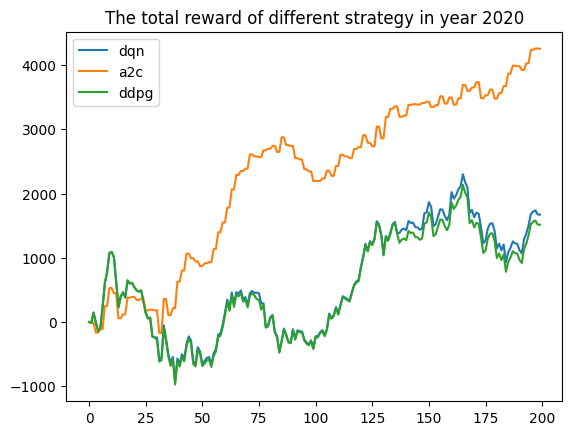

In [32]:
import matplotlib.pyplot as plt

plt.plot(np.arange(len(total_reward_list_dqn)),total_reward_list_dqn,label='dqn')
plt.plot(np.arange(len(total_reward_list_a2c)),total_reward_list_a2c,label='a2c')
plt.plot(np.arange(len(total_reward_list_ddpg)),total_reward_list_ddpg,label='ddpg')
plt.legend()
plt.title('The total reward of different strategy in year 2020')